# <center>     Fraud Transaction Detection  </center>

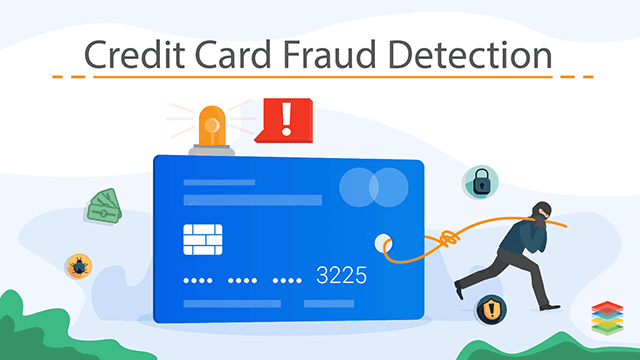

 <center>
    
## ABOUT THE DATASET
  </center>

- The datasets contains transactions made by credit cards in September 2013 by european cardholders. This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions.

- It contains only numerical input variables which are the result of a PCA transformation.

- Due to confidentiality issues, there are not provided the original features and more background information about the data.

- Features V1, V2, ... V28 are the principal components obtained with PCA;
    The only features which have not been transformed with PCA are Time and Amount. Feature Time contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature Amount is the transaction Amount, this feature can be used for example-dependant cost-senstive learning.
    Feature Class is the response variable and it takes value 1 in case of fraud and 0 otherwise.


 <center>

## Objective

Developed and implemented a robust machine learning model for Fraud Transaction Detection, contributing to enhanced security in financial transactions. Leveraged cutting-edge algorithms to identify potentially fraudulent credit card transactions, minimizing false positives, and ensuring a more secure digital financial ecosystem. 💻🔒

</center>

# Importing Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Loading the Dataset

In [2]:
df =pd.read_csv (r"E:\INTERNSHIP\TechnoHacks project\4.creditcards\4.creditcard.csv")

In [3]:
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [4]:
df.tail()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
284802,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
284803,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
284804,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
284805,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0
284806,172792.0,-0.533413,-0.189733,0.703337,-0.506271,-0.012546,-0.649617,1.577006,-0.414650,0.486180,...,0.261057,0.643078,0.376777,0.008797,-0.473649,-0.818267,-0.002415,0.013649,217.00,0


# Exploring the Dataset

In [5]:
df.shape

(284807, 31)

In [6]:
df.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [7]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,...,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [8]:
df.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

# Data Cleaning

In [9]:
df.duplicated().sum()

1081

In [10]:
df.drop_duplicates(keep='last',inplace=True)

# Exploratory Data Analysis (EDA)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 283726 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    283726 non-null  float64
 1   V1      283726 non-null  float64
 2   V2      283726 non-null  float64
 3   V3      283726 non-null  float64
 4   V4      283726 non-null  float64
 5   V5      283726 non-null  float64
 6   V6      283726 non-null  float64
 7   V7      283726 non-null  float64
 8   V8      283726 non-null  float64
 9   V9      283726 non-null  float64
 10  V10     283726 non-null  float64
 11  V11     283726 non-null  float64
 12  V12     283726 non-null  float64
 13  V13     283726 non-null  float64
 14  V14     283726 non-null  float64
 15  V15     283726 non-null  float64
 16  V16     283726 non-null  float64
 17  V17     283726 non-null  float64
 18  V18     283726 non-null  float64
 19  V19     283726 non-null  float64
 20  V20     283726 non-null  float64
 21  V21     283726 

In [12]:
df['Class'].unique

<bound method Series.unique of 0         0
1         0
2         0
3         0
4         0
         ..
284802    0
284803    0
284804    0
284805    0
284806    0
Name: Class, Length: 283726, dtype: int64>

In [13]:
df['Class'].value_counts()

Class
0    283253
1       473
Name: count, dtype: int64

In [14]:
print(df['Class'].value_counts()/len(df)*100)

Class
0    99.83329
1     0.16671
Name: count, dtype: float64


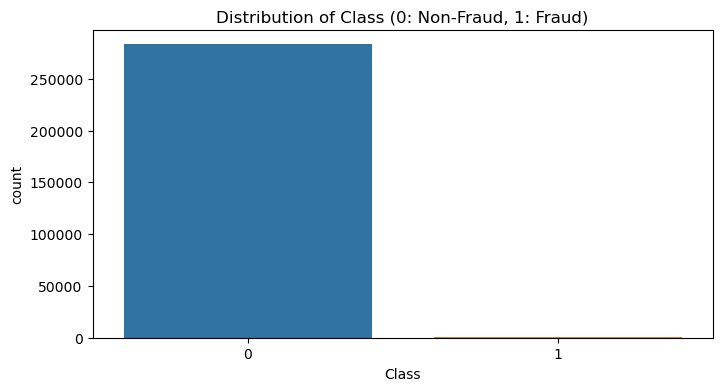

In [15]:

plt.figure(figsize=(8, 4))
sns.countplot(x='Class', data=df)
plt.title('Distribution of Class (0: Non-Fraud, 1: Fraud)')
plt.show()

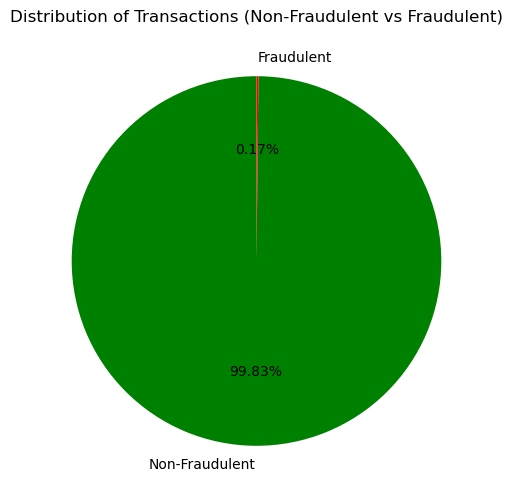

In [52]:
fraud_counts = df['Class'].value_counts()
labels = ['Non-Fraudulent', 'Fraudulent']


plt.figure(figsize=(6, 6))
plt.pie(fraud_counts, labels=labels, autopct='%0.2f%%', startangle=90, colors = ['green','Red'])
plt.title('Distribution of Transactions (Non-Fraudulent vs Fraudulent)')
plt.show()


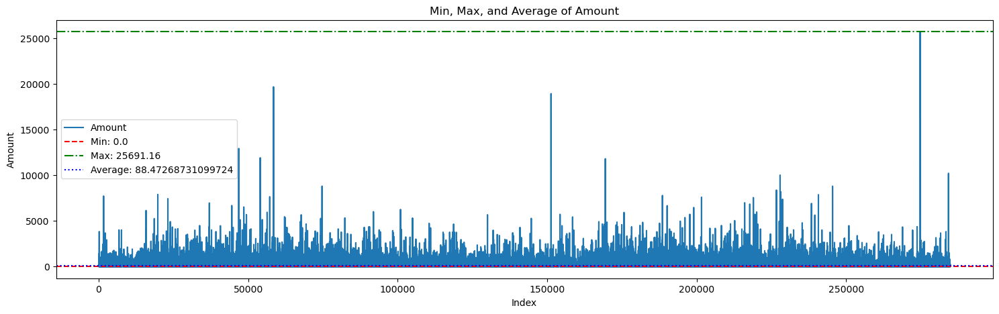

In [17]:
min_val = df['Amount'].min()
max_val = df['Amount'].max()
avg_val = df['Amount'].mean()

plt.figure(figsize=(18, 5))
sns.lineplot(data=df['Amount'], label='Amount')
plt.axhline(y=min_val, color='r', linestyle='--', label=f'Min: {min_val}')  
plt.axhline(y=max_val, color='g', linestyle='-.', label=f'Max: {max_val}') 
plt.axhline(y=avg_val, color='b', linestyle=':', label=f'Average: {avg_val}')  
plt.xlabel('Index')
plt.ylabel('Amount')
plt.title('Min, Max, and Average of Amount')
plt.legend()
plt.show()

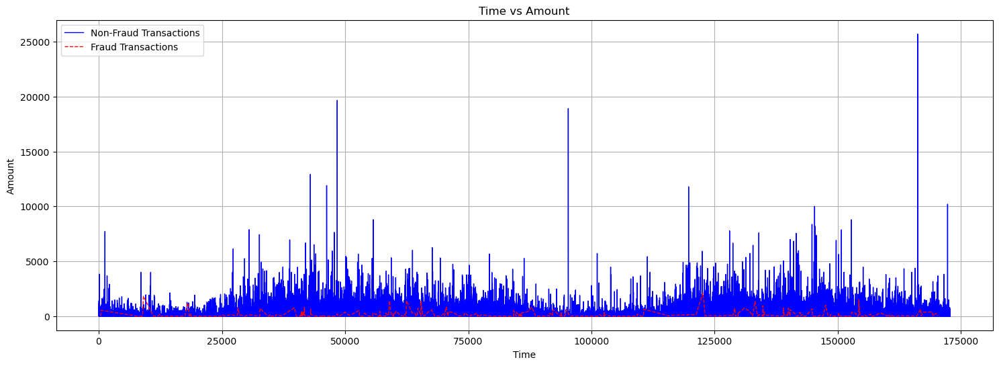

In [18]:

fraud = df[df['Class'] == 1]
non_fraud = df[df['Class'] == 0]


plt.figure(figsize=(18, 6))
plt.plot(non_fraud['Time'], non_fraud['Amount'], color='blue', linewidth=1, label='Non-Fraud Transactions')
plt.plot(fraud['Time'], fraud['Amount'], color='red', linewidth=1, label='Fraud Transactions', linestyle='dashed')
plt.title('Time vs Amount')
plt.xlabel('Time')
plt.ylabel('Amount')
plt.legend()
plt.grid(True)
plt.show()

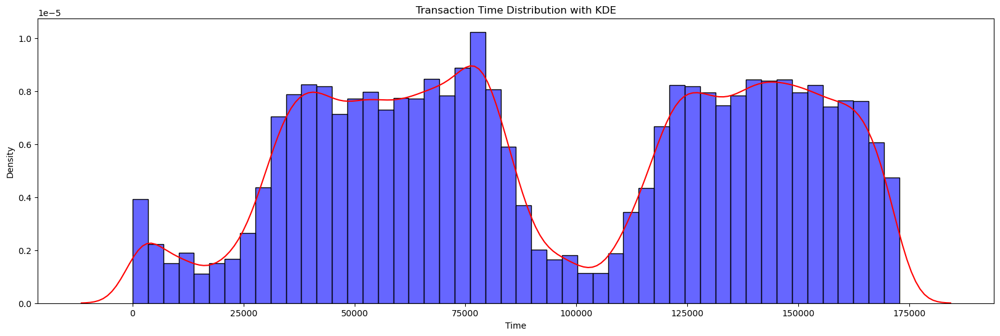

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(20, 6))

# Histogram
sns.histplot(df['Time'], bins=50, kde=False, color='blue', stat='density', alpha=0.6)

# KDE Line
sns.kdeplot(df['Time'], color='red')

plt.title("Transaction Time Distribution with KDE")
plt.xlabel("Time")
plt.ylabel("Density")
plt.show()


In [20]:
fraudulent_transactions = df[df['Class'] == 1]
fraudulent_transactions.T

,541,623,4920,6108,6329,6331,6334,6336,6338,6427,...,274382,274475,275992,276071,276864,279863,280143,280149,281144,281674
Time,406.000000,472.000000,4462.000000,6986.000000,7519.000000,7526.000000,7535.000000,7543.000000,7551.000000,7610.000000,...,165981.000000,166028.000000,166831.000000,166883.000000,167338.000000,169142.000000,169347.000000,169351.000000,169966.000000,170348.000000
V1,-2.312227,-3.043541,-2.303350,-4.397974,1.234235,0.008430,0.026779,0.329594,0.316459,0.725646,...,-5.766879,-0.956390,-2.027135,2.091900,-1.374424,-1.927883,1.378559,-0.676143,-3.113832,1.991976
V2,1.951992,-3.157307,1.759247,1.358367,3.019740,4.137837,4.132464,3.712889,3.809076,2.300894,...,-8.402154,2.361594,-1.131890,-0.757459,2.793185,1.125653,1.289381,1.126366,0.585864,0.158476
V3,-1.609851,1.088463,-0.359745,-2.592844,-4.304597,-6.240697,-6.560600,-5.775935,-5.615159,-5.329976,...,0.056543,-3.171195,-1.135194,-1.192258,-4.346572,-4.518331,-5.004247,-2.213700,-5.399730,-2.583441
V4,3.997906,2.288644,2.330243,2.679787,4.732795,6.675732,6.348557,6.078266,6.047445,4.007683,...,6.950983,1.970759,1.086963,-0.755458,2.400731,1.749293,1.411850,0.468308,1.817092,0.408670
V5,-0.522188,1.359805,-0.821628,-1.128131,3.624201,0.768307,1.329666,1.667359,1.554026,-1.730411,...,9.880564,0.474761,-0.010547,-0.620324,-1.688433,-1.566487,0.442581,-1.120541,-0.840618,1.151147
V6,-1.426545,-1.064823,-0.075788,-1.706536,-1.357746,-3.353060,-2.513479,-2.420168,-2.651353,-1.732193,...,-5.773192,-1.902598,0.423797,-0.322077,0.111136,-2.010494,-1.326536,-0.003346,-2.943548,-0.096695
V7,-2.537387,0.325574,0.562320,-3.496197,1.713445,-1.631735,-1.689102,-0.812891,-0.746579,-3.968593,...,-5.748879,-0.055178,3.790880,-1.082511,-0.922038,-0.882850,-1.413170,-2.234739,-2.208002,0.223050
V8,1.391657,-0.067794,-0.399147,-0.248778,-0.496358,0.154612,0.303253,0.133080,0.055586,1.063728,...,0.721743,0.277831,-1.155595,0.117200,-2.149930,0.697211,0.248525,1.210158,1.058733,-0.068384
V9,-2.770089,-0.270953,-0.238253,-0.247768,-1.282858,-2.795892,-3.139409,-2.214311,-2.678679,-0.486097,...,-1.076274,-1.745854,-0.063434,-0.140927,-2.027474,-2.064945,-1.127396,-0.652250,-1.632333,0.577829


In [21]:

fraudulent_transactions = df[df['Class'] == 1]


num_fraudulent_transactions = len(fraudulent_transactions)


total_fraudulent_amount = fraudulent_transactions['Amount'].sum()


non_fraudulent_transactions = df[df['Class'] == 0]

num_non_fraudulent_transactions = len(non_fraudulent_transactions)


total_non_fraudulent_amount = non_fraudulent_transactions['Amount'].sum()


print(f'Number of fraudulent transactions: {num_fraudulent_transactions}')
print(f'Total amount of fraudulent transactions: {total_fraudulent_amount:.2f}')


print(f'Number of non-fraudulent transactions: {num_non_fraudulent_transactions}')
print(f'Total amount of non-fraudulent transactions: {total_non_fraudulent_amount:.2f}')



Number of fraudulent transactions: 473
Total amount of fraudulent transactions: 58591.39
Number of non-fraudulent transactions: 283253
Total amount of non-fraudulent transactions: 25043410.29


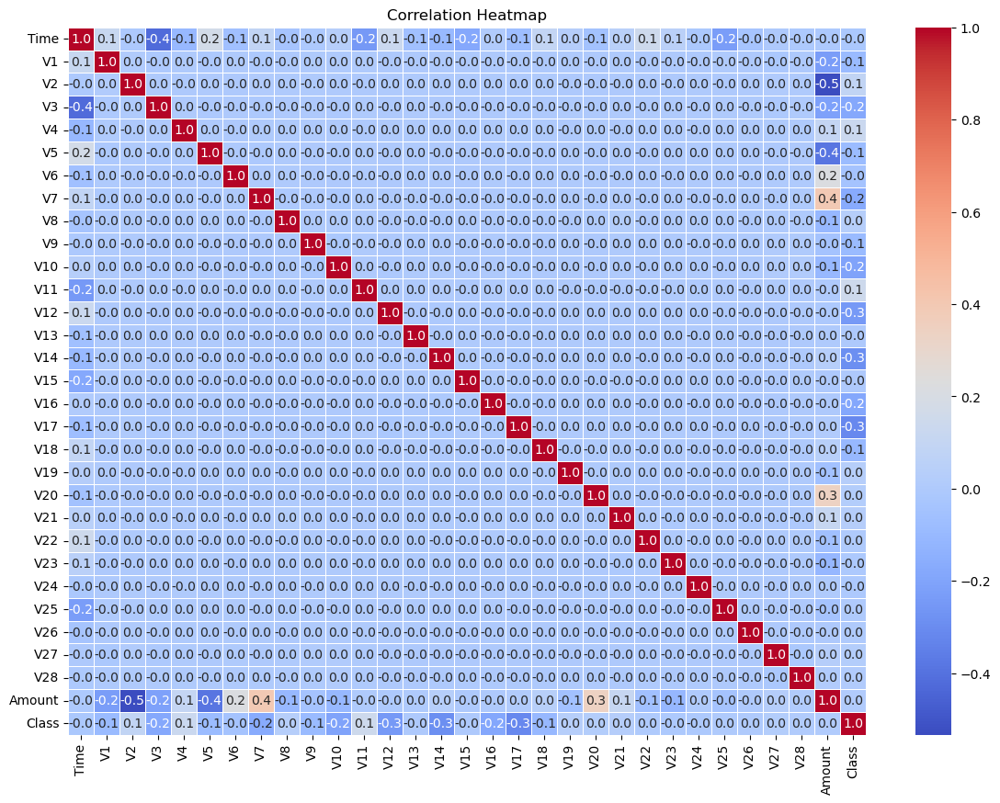

In [22]:

plt.figure(figsize=(14, 10))
corr_matrix = df.corr()
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.1f', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

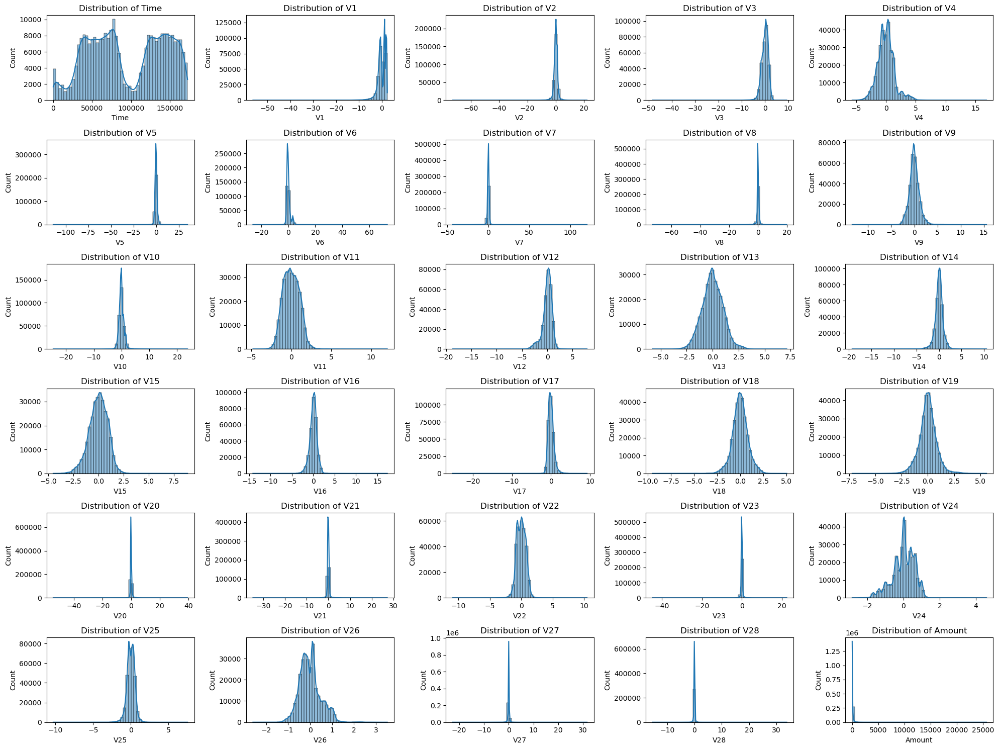

In [23]:

features = df.columns[:-1]  

plt.figure(figsize=(20, 15))


for i, feature in enumerate(features):
    plt.subplot(6, 5, i+1)  # 6 rows, 5 columns for subplots
    sns.histplot(df[feature], bins=50, kde=True)
    plt.title(f'Distribution of {feature}')

# Adjust layout to prevent overlap
plt.tight_layout()


plt.show()

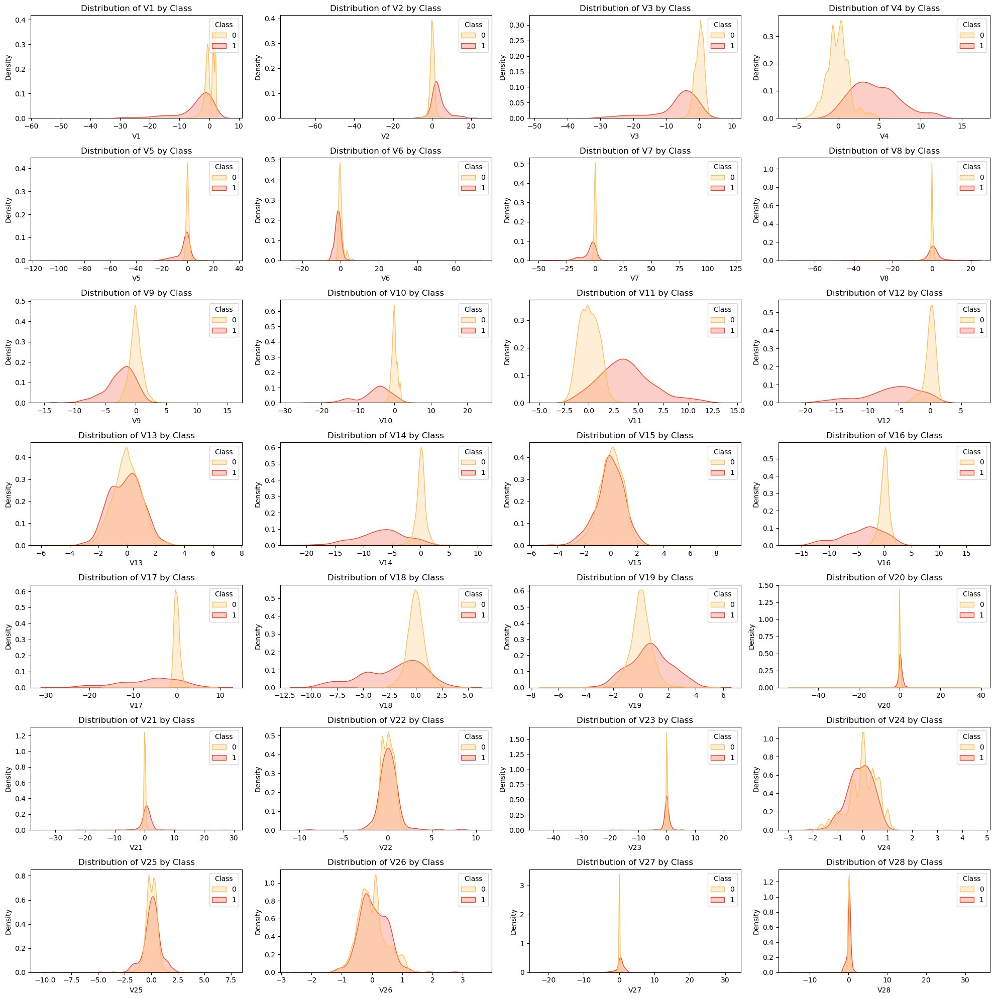

In [24]:

plt.figure(figsize=(20, 20))

# Loop through the features V1 to V28
for i, col in enumerate(df.columns[1:29], 1):
    plt.subplot(7, 4, i)  
    sns.kdeplot(data=df, x=col, hue='Class', fill=True, common_norm=False, palette='YlOrRd')
    plt.title(f'Distribution of {col} by Class')


plt.tight_layout()
plt.show()

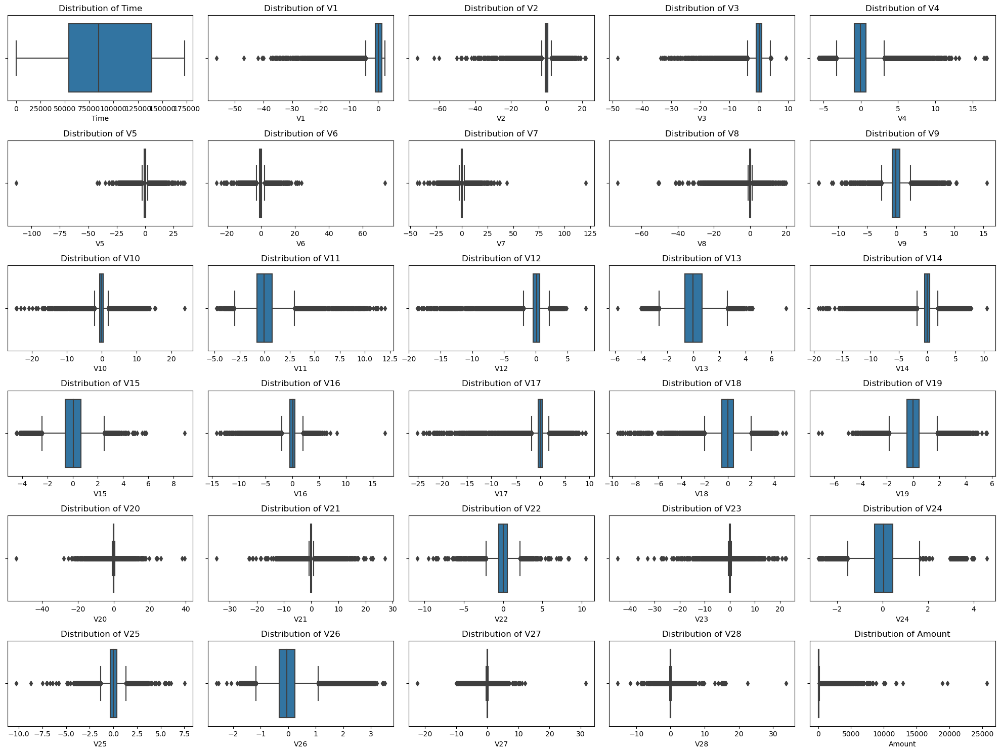

In [25]:
# outlier detect

features = df.columns[:-1]


plt.figure(figsize=(20, 15))

for i, feature in enumerate(features):
    plt.subplot(6, 5, i+1)
    sns.boxplot(x=df[feature])
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()


In [26]:
# Define the features (excluding the target column 'Class')
features = df.columns[:-1]

# Filter the DataFrame for Class 0 and Class 1
df_class_0 = df[df['Class'] == 0].copy()
df_class_1 = df[df['Class'] == 1].copy()

# Initialize dictionary to store the number of outliers for each feature before and after removal
outliers_count_before_class_0 = {}
outliers_count_after_class_0 = {}

# Total number of observations in Class 0 before removing outliers
total_observations_class_0_before = len(df_class_0)

# Calculate outliers before removal for Class 0
for feature in features:
    # Calculate the IQR and bounds
    Q1 = df_class_0[feature].quantile(0.25)
    Q3 = df_class_0[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Count outliers before removal
    outliers_before = np.sum((df_class_0[feature] < lower_bound) | (df_class_0[feature] > upper_bound))
    outliers_count_before_class_0[feature] = outliers_before

# Total number of outliers before removal for Class 0
total_outliers_class_0_before = sum(outliers_count_before_class_0.values())

# Perform outlier removal based on quantiles for Class 0
quantiles_class_0 = {
    'V1': 0.9975, 'V2': 0.9978, 'V3': 0.9983, 'V4': 0.9979, 'V5': 0.9969,
    'V6': 0.9993, 'V7': 0.9993, 'V8': 0.9977, 'V9': 0.9911, 'V10': 0.9971,
    'V11': 0.9901, 'V12': 0.9981, 'V13': 0.9982, 'V14': 0.9984, 'V15': 0.9998,
    'V16': 0.9912, 'V17': 0.9941, 'V18': 0.9987, 'V19': 0.9942, 'V20': 0.9979,  
    'V21': 0.9992, 'V22': 0.9904, 'V23': 0.9929, 'V24': 0.9932, 'V25': 0.9912,
    'V26': 0.9900, 'V27': 0.9933, 'V28': 0.9970, 'Amount': 0.9991
}

for feature, quantile in quantiles_class_0.items():
    q = df_class_0[feature].quantile(quantile)
    df_class_0 = df_class_0[df_class_0[feature] < q]

# Total number of observations in Class 0 after removing outliers
total_observations_class_0_after = len(df_class_0)

# Calculate outliers after removal for Class 0
for feature in features:
    Q1 = df_class_0[feature].quantile(0.25)
    Q3 = df_class_0[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Count outliers after removal (should be 0 or very few)
    outliers_after = np.sum((df_class_0[feature] < lower_bound) | (df_class_0[feature] > upper_bound))
    outliers_count_after_class_0[feature] = outliers_after

# Total number of outliers after removal for Class 0
total_outliers_class_0_after = sum(outliers_count_after_class_0.values())

# Calculate statistics for Class 0
total_outliers_class_0_removed = total_outliers_class_0_before - total_outliers_class_0_after
percentage_outliers_class_0_removed = (total_outliers_class_0_removed / total_outliers_class_0_before) * 100

# Create a DataFrame to store the results for Class 0
outliers_class_0_df = pd.DataFrame({
    'Feature': features,
    'Before_Outliers': [outliers_count_before_class_0[feature] for feature in features],
    'Before (%)': [round((outliers_count_before_class_0[feature] / total_observations_class_0_before) * 100, 2) for feature in features],
    'After_Outliers': [outliers_count_after_class_0[feature] for feature in features],
    'After (%)': [round((outliers_count_after_class_0[feature] / total_observations_class_0_after) * 100, 2) for feature in features],
    'Kept_Outlier (%)': [round(quantiles_class_0.get(feature, np.nan) * 100, 2) for feature in features]
})

# Combine the cleaned Class 0 data back with the Class 1 data
df_cleaned_class_0 = df_class_0
df_combined = pd.concat([df_cleaned_class_0, df_class_1])


print(f"\nTotal number of outliers in Class 0 before removal: {total_outliers_class_0_before} ({round((total_outliers_class_0_before / total_observations_class_0_before) * 100, 2)}%)")
print(f"Total number of outliers present in Class 0 after removal: {total_outliers_class_0_after} ({round((total_outliers_class_0_after / total_observations_class_0_after) * 100, 2)}%)")
print(f"Total number of outliers removed from Class 0: {total_outliers_class_0_removed}")
print(f"Percentage of outliers removed from Class 0: {round(percentage_outliers_class_0_removed, 2)}%")


print(f"\nCombined DataFrame with cleaned Class 0 and original Class 1 data:")

outliers_class_0_df


Total number of outliers in Class 0 before removal: 363104 (128.19%)
Total number of outliers present in Class 0 after removal: 258234 (102.85%)
Total number of outliers removed from Class 0: 104870
Percentage of outliers removed from Class 0: 28.88%

Combined DataFrame with cleaned Class 0 and original Class 1 data:


,Feature,Before_Outliers,Before (%),After_Outliers,After (%),Kept_Outlier (%)
0,Time,0,0.00,0,0.00,NaN
1,V1,6810,2.40,1468,0.58,99.75
2,V2,13200,4.66,6122,2.44,99.78
3,V3,3058,1.08,1056,0.42,99.83
4,V4,10873,3.84,9543,3.80,99.79
5,V5,12061,4.26,8589,3.42,99.69
6,V6,22764,8.04,18917,7.53,99.93
7,V7,8578,3.03,3598,1.43,99.93
8,V8,23778,8.39,17315,6.90,99.77
9,V9,8028,2.83,5848,2.33,99.11


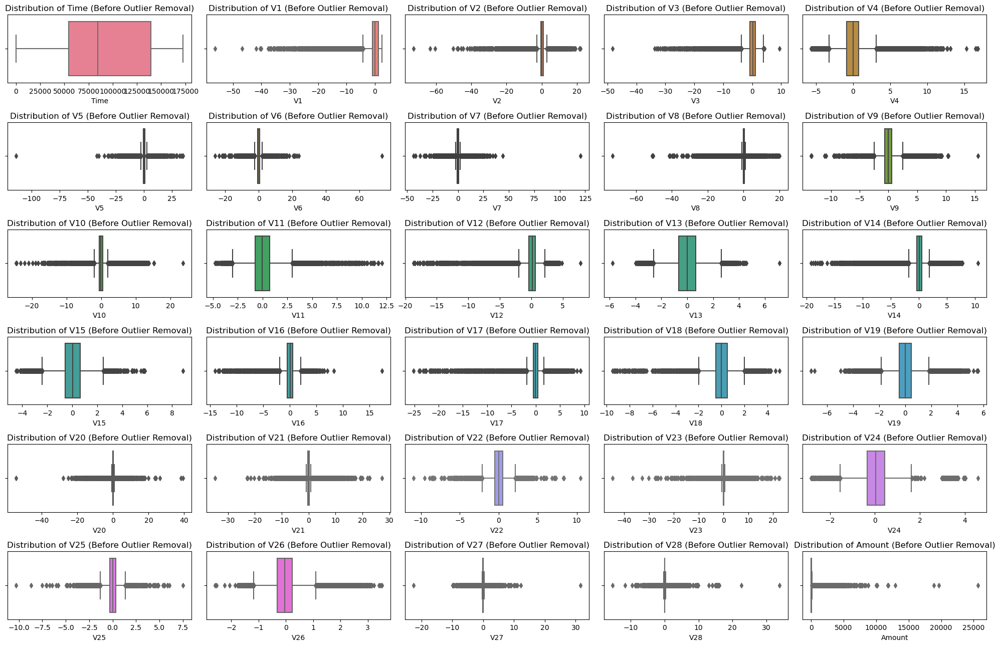

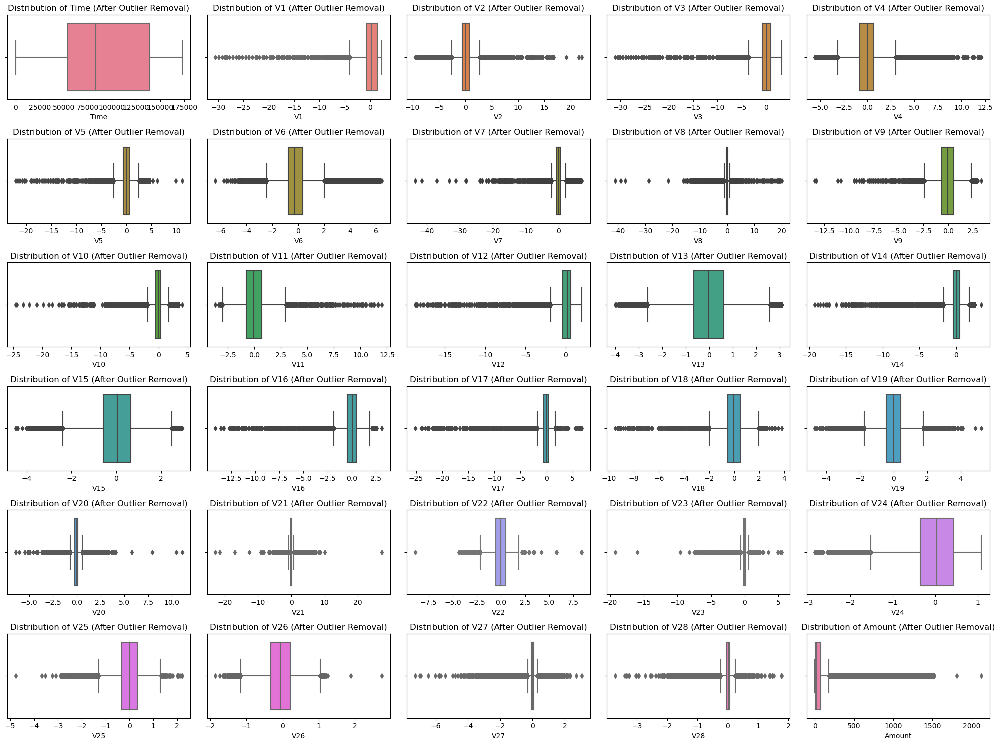

In [27]:
palette = sns.color_palette("husl", len(features))  

plt.figure(figsize=(20, 13))

for i, feature in enumerate(features):
    plt.subplot(6, 5, i+1)
    sns.boxplot(x=df[feature], color=palette[i])
    plt.title(f'Distribution of {feature} (Before Outlier Removal)')

plt.tight_layout()
plt.show()

plt.figure(figsize=(20, 15))

for i, feature in enumerate(features):
    plt.subplot(6, 5, i+1)
    sns.boxplot(x=df_combined[feature], color=palette[i])
    plt.title(f'Distribution of {feature} (After Outlier Removal)')

plt.tight_layout()
plt.show()


In [28]:
df_combined.shape

(251555, 31)

In [29]:
df.shape

(283726, 31)

In [30]:
283726-251555

32171

In [31]:
df['Class'].value_counts()

Class
0    283253
1       473
Name: count, dtype: int64

In [32]:
df_combined['Class'].value_counts()

Class
0    251082
1       473
Name: count, dtype: int64

# Model Training and Evaluation

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [34]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import RocCurveDisplay

In [35]:
from sklearn.metrics import classification_report, roc_auc_score, accuracy_score
from imblearn.over_sampling import SMOTE


In [36]:
X = df_combined.drop(columns=['Class']).values
y = df_combined['Class'].values


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


In [37]:
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


In [38]:
#scaler = StandardScaler()

#X_train_scaled = scaler.fit_transform(df[["Amount"]])
#X_test_scaled = scaler.fit_transform(df[["Time"]])

In [39]:
X_test_scaled

array([[ 0.30073138, -0.87722468, -0.90764561, ...,  0.21766917,
         1.69476828,  3.09265394],
       [ 0.5823388 ,  1.26654518, -1.51356446, ...,  0.30506238,
        -0.39527645, -0.25571534],
       [ 0.89282794, -0.13236738,  0.33902499, ...,  0.28092221,
         0.66834512, -0.48373822],
       ...,
       [-0.91590596, -0.6041156 ,  0.07516336, ...,  0.4318038 ,
        -0.31516947, -0.16516753],
       [ 0.98649209,  1.10905091, -1.33086114, ...,  0.1264054 ,
        -0.37548179,  0.18049011],
       [ 1.21667647, -0.0776772 ,  0.84332111, ...,  0.86206918,
         0.50897152, -0.45179672]])

# Handling Imbalanced Data

In [40]:
# Apply SMOTE to the training data

smote =SMOTE(random_state=42, k_neighbors=5) 
X_train_res, y_train_res = smote.fit_resample(X_train_scaled, y_train)

In [41]:
pd.Series(y_train_res).value_counts()

0    175749
1    175749
Name: count, dtype: int64

In [42]:
pd.Series(y_train).value_counts()

0    175749
1       339
Name: count, dtype: int64

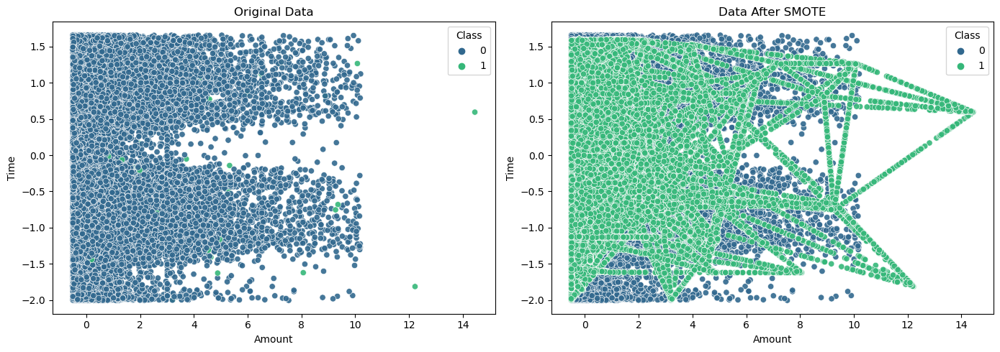

In [43]:
# Create a DataFrame for original and resampled data for visualization
column_names = df_combined.drop(columns=['Class']).columns


df_original = pd.DataFrame(X_train_scaled, columns=column_names)
df_original['Class'] = y_train

df_resampled = pd.DataFrame(X_train_res, columns=column_names)
df_resampled['Class'] = y_train_res


plt.figure(figsize=(14, 5))

# Plot for original data
plt.subplot(1, 2, 1)
sns.scatterplot(x=df_original['Amount'], y=df_original['Time'], hue=df_original['Class'], palette='viridis', alpha=0.9)
plt.title('Original Data')
plt.xlabel('Amount')
plt.ylabel('Time')

# Plot for resampled data
plt.subplot(1, 2, 2)
sns.scatterplot(x=df_resampled['Amount'], y=df_resampled['Time'], hue=df_resampled['Class'], palette='viridis', alpha=0.9)
plt.title('Data After SMOTE')
plt.xlabel('Amount')
plt.ylabel('Time')

# Show the plots
plt.tight_layout()
plt.show()


In [44]:
# Helper function to plot confusion matrix
def plot_confusion_matrix(y_test, y_pred, title):
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(6,4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(title)
    plt.ylabel('Actual')
    plt.xlabel('Predicted')
    plt.show()


# Logistic Regression

Logistic Regression Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.98      0.99     75333
           1       0.06      0.90      0.12       134

    accuracy                           0.98     75467
   macro avg       0.53      0.94      0.55     75467
weighted avg       1.00      0.98      0.99     75467

The Test set score / accuracy of Logistic Regression is: 97.66%
Logistic Regression Training set score:95.79%


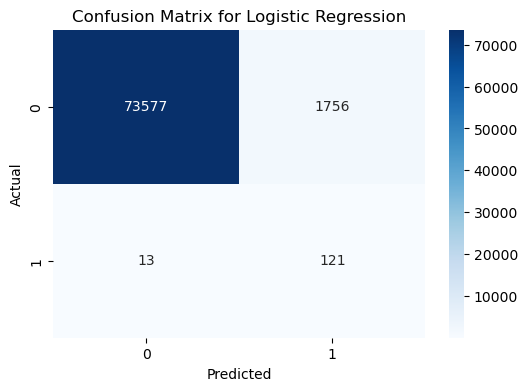

Logistic Regression ROC AUC score: 0.9703


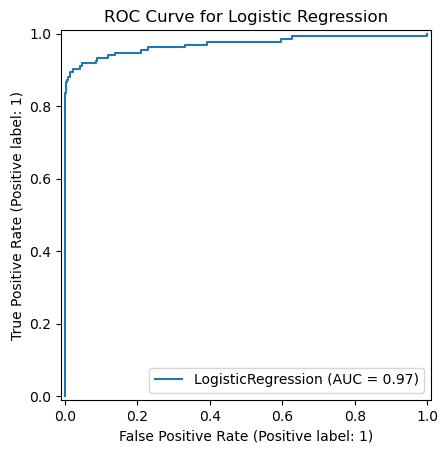

In [45]:

lr = LogisticRegression()
lr.fit(X_train_res, y_train_res)
predicted_lr = lr.predict(X_test_scaled)
train_score_lr = round(lr.score(X_train_res, y_train_res)* 100, 2)
test_score_lr = round(lr.score(X_test_scaled, y_test)* 100, 2)

print('Logistic Regression Classification Report:\n', classification_report(y_test, predicted_lr))
lr_accuracy = round(accuracy_score(y_test, predicted_lr) * 100, 2)
print('The Test set score / accuracy of Logistic Regression is: {}%'.format(lr_accuracy))

print('Logistic Regression Training set score:{}%'.format(train_score_lr))
#print('Logistic Regression Test set score:{}%'.format(test_score_lr))


plot_confusion_matrix(y_test, predicted_lr, 'Confusion Matrix for Logistic Regression')

predicted_prob_lr = lr.predict_proba(X_test_scaled)[:, 1]
roc_auc_lr = roc_auc_score(y_test, predicted_prob_lr)
print('Logistic Regression ROC AUC score: {:.4f}'.format(roc_auc_lr))
RocCurveDisplay.from_estimator(lr, X_test_scaled, y_test)
plt.title('ROC Curve for Logistic Regression')
plt.show()


# Decision Tree Classifier

Decision Tree Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     75333
           1       0.39      0.82      0.53       134

    accuracy                           1.00     75467
   macro avg       0.69      0.91      0.76     75467
weighted avg       1.00      1.00      1.00     75467

The Test set score / accuracy of Decision Tree is: 99.74%
Decision Tree Training set score: 100.0%


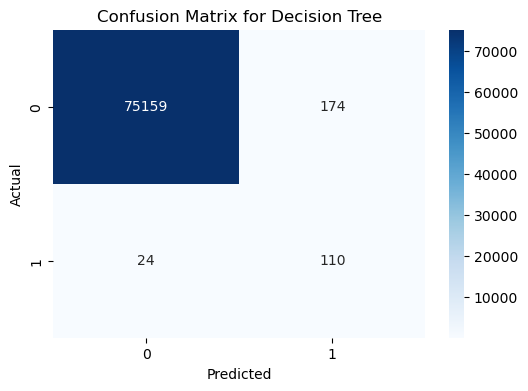

Decision Tree ROC AUC score: 0.9093


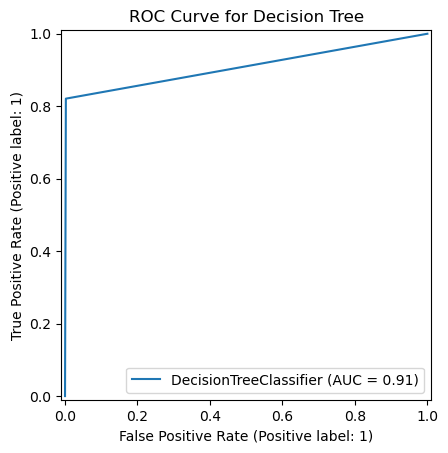

In [46]:


dt = DecisionTreeClassifier(random_state=42)
dt.fit(X_train_res, y_train_res)
predicted_dt = dt.predict(X_test_scaled)
train_score_dt = round(dt.score(X_train_res, y_train_res) * 100, 2)
test_score_dt = round(dt.score(X_test_scaled, y_test) * 100, 2)


print('Decision Tree Classification Report:\n', classification_report(y_test, predicted_dt))
print('The Test set score / accuracy of Decision Tree is: {}%'.format(round(accuracy_score(y_test, predicted_dt) * 100, 2)))
print('Decision Tree Training set score: {}%'.format(train_score_dt))
# print('Decision Tree Test set score: {}%'.format(test_score_dt))


plot_confusion_matrix(y_test, predicted_dt, 'Confusion Matrix for Decision Tree')


predicted_prob_dt = dt.predict_proba(X_test_scaled)[:, 1]
roc_auc_dt = roc_auc_score(y_test, predicted_prob_dt)
print('Decision Tree ROC AUC score: {:.4f}'.format(roc_auc_dt))

RocCurveDisplay.from_estimator(dt, X_test_scaled, y_test)
plt.title('ROC Curve for Decision Tree')
plt.show()

# Random Forest Classifier

Random Forest Classification Report:
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     75333
           1       0.92      0.78      0.85       134

    accuracy                           1.00     75467
   macro avg       0.96      0.89      0.92     75467
weighted avg       1.00      1.00      1.00     75467

The Test set score / accuracy of Random Forest is: 99.95%
Random Forest Training set score: 100.0%


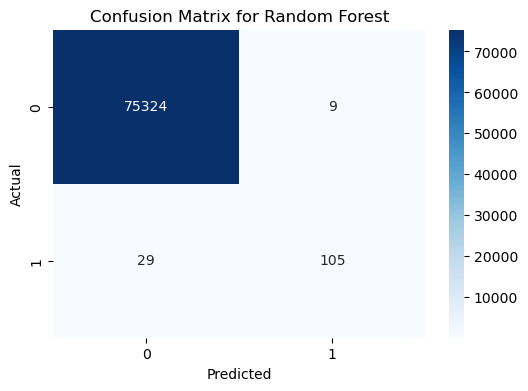

Random Forest ROC AUC score: 0.9853


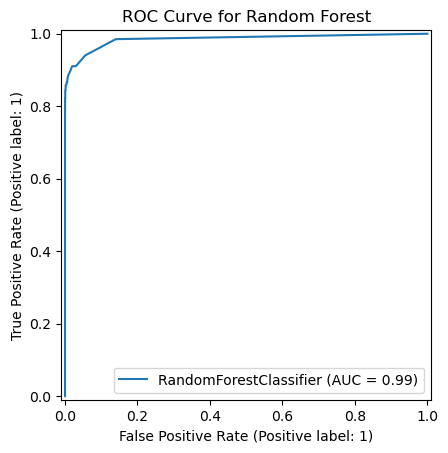

In [47]:
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train_res, y_train_res)
predicted_rf = rf.predict(X_test_scaled)
train_score_rf = round(rf.score(X_train_res, y_train_res) * 100, 2)
test_score_rf = round(rf.score(X_test_scaled, y_test) * 100, 2)

print('Random Forest Classification Report:\n', classification_report(y_test, predicted_rf))
print('The Test set score / accuracy of Random Forest is: {}%'.format(round(accuracy_score(y_test, predicted_rf) * 100, 2)))
print('Random Forest Training set score: {}%'.format(train_score_rf))
#print('Random Forest Test set score: {}%'.format(test_score_rf))

# Plot Confusion Matrix for Random Forest
plot_confusion_matrix(y_test, predicted_rf, 'Confusion Matrix for Random Forest')


predicted_prob_rf = rf.predict_proba(X_test_scaled)[:, 1]
roc_auc_rf = roc_auc_score(y_test, predicted_prob_rf)
print('Random Forest ROC AUC score: {:.4f}'.format(roc_auc_rf))


RocCurveDisplay.from_estimator(rf, X_test_scaled, y_test)
plt.title('ROC Curve for Random Forest')
plt.show()

# Prediction

In [48]:
scaler = StandardScaler()
scaler.fit(X_train)  # X_train should be the training data used for scaling

# Define the example feature vector
sample_input = [[406.000000, -2.312227, 1.951992, -1.609851, 3.997906, -0.522188, 
                 -1.426545, -2.537387, 1.391657, -2.770089, -2.772272, 3.202033, 
                 -2.899907, -0.595222, -4.289254, 0.389724, -1.140747, -2.830056, 
                 -0.016822, 0.416956, 0.126911, 0.517232, -0.035049, -0.465211, 
                 0.320198, 0.044519, 0.177840, 0.261145, -0.143276, 0.00]]

# Standardize the input
sample_input_scaled = scaler.transform(sample_input)


predicted_class_lr = lr.predict(sample_input_scaled)
print(f'Logistic Regression Prediction: {predicted_class_lr[0]}')


predicted_class_rf = rf.predict(sample_input_scaled)
print(f'Random Forest Prediction: {predicted_class_rf[0]}')


predicted_class_dt = dt.predict(sample_input_scaled)              
print(f'Decision Tree Prediction: {predicted_class_dt[0]}')            # CLASS '1' shows right prediction fraud transactions



Logistic Regression Prediction: 1
Random Forest Prediction: 1
Decision Tree Prediction: 1


In [49]:
df_combined[df_combined['Class'] == 1].head(2)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
541,406.0,-2.312227,1.951992,-1.609851,3.997906,-0.522188,-1.426545,-2.537387,1.391657,-2.770089,...,0.517232,-0.035049,-0.465211,0.320198,0.044519,0.177840,0.261145,-0.143276,0.0,1
623,472.0,-3.043541,-3.157307,1.088463,2.288644,1.359805,-1.064823,0.325574,-0.067794,-0.270953,...,0.661696,0.435477,1.375966,-0.293803,0.279798,-0.145362,-0.252773,0.035764,529.0,1


In [50]:
new_sample_input = [[0,-1.359807134, -0.072781173, 2.536346738, 1.378155224, -0.33832077,
     0.462387778, 0.239598554, 0.098697901, 0.36378697, 0.090794172,
     -0.551599533, -0.617800856, -0.991389847, -0.311169354, 1.468176972,
     -0.470400525, 0.207971242, 0.02579058, 0.40399296, 0.251412098,
     -0.018306778, 0.277837576, -0.11047391, 0.066928075, 0.128539358,
     -0.189114844, 0.133558377, -0.021053053, 149.62]]


new_sample_input_scaled = scaler.transform(new_sample_input)

predicted_class_lr_new = lr.predict(new_sample_input_scaled)
print(f'Logistic Regression Prediction: {predicted_class_lr_new[0]}')

predicted_class_rf_new = rf.predict(new_sample_input_scaled)
print(f'Random Forest Prediction: {predicted_class_rf_new[0]}')

predicted_class_dt_new = dt.predict(new_sample_input_scaled)
print(f'Decision Tree Prediction: {predicted_class_dt_new[0]}')    # CLASS '0' shows right prediction non-fraud transactions


Logistic Regression Prediction: 0
Random Forest Prediction: 0
Decision Tree Prediction: 0


In [51]:
df_combined[df_combined['Class'] == 0].head(2)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0


# Conclusion

*The dataset represents credit card transactions from European cardholders over two days in September 2013. It includes 284,807 transactions, of which only 492 (0.172%) are fraudulent, making the dataset highly imbalanced. The features are primarily principal components (V1 to V28) derived from PCA, with two exceptions: Time (elapsed seconds between transactions) and Amount (transaction value). The target variable Class indicates fraud (1) or non-fraud (0). Due to its imbalance, this dataset presents challenges in accurately detecting fraud, requiring techniques like resampling and cost-sensitive learning for effective modeling.*

# Project Learning

- I gained insights into techniques for dealing with highly imbalanced datasets, where fraud cases are rare compared to legitimate transactions, highlighting the importance of strategies like resampling and anomaly detection.
-  Time represents the elapsed time since the first transaction, and Amount denotes transaction values. These features can be critical for cost-sensitive learning and temporal analysis of transactions.
- Evaluating models using metrics suited for imbalanced datasets (e.g., ROC AUC, precision-recall curves) is critical for understanding their performance in detecting rare events and ensuring they are effective in real-world scenarios.

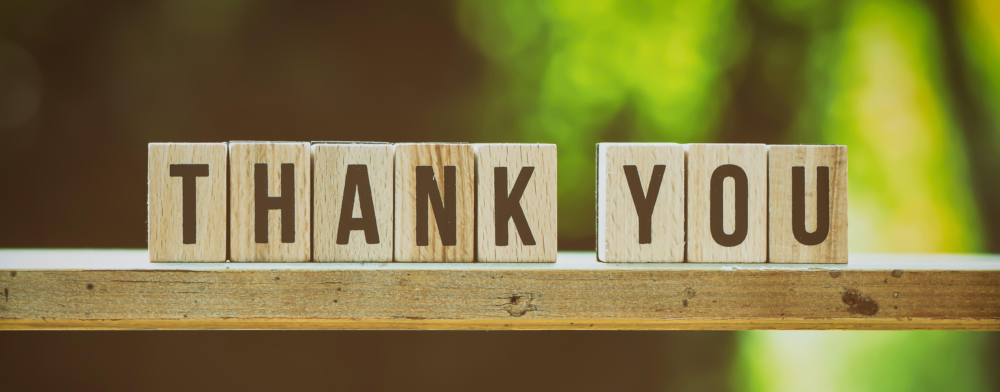